In [121]:
# Model design
import agentpy as ap
import networkx as nx
import random
import numpy as np

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import IPython

random.seed(42)
#rng = np.random.default_rng(seed=42)

In [171]:
class Person(ap.Agent):

    def setup(self):
        """ Initialize a new variable at agent creation. """
        self.condition = 0  # Susceptible/None = 0, Infected/Buy = 1, Recovered/Sell = 2, Store = 3
        self.production = random.randrange(0,10,1) # (start,stop, step) + random.random() # float part
        self.consumption = random.randrange(1,10,1) #+ random.random() # float part
        self.storage_cap = random.randrange(0,10,1) #+ random.random() # float part
        self.energy_bal = self.production - self.consumption
        self.storage_util = 0
        self.energy_trans = 0
        self.flag = 'init'
        self.color = 'blue'

        
    def energy_decision(self):
        #print(self.energy_bal)
        if self.energy_bal > 0:
            # sell energy to neighbor who wants to buy it OR STORE - set flag to store
            self.flag = 'sell'                                                       # or make this 0, 1, 2 for nothing, buy, sell???
            self.color = 'green'
            for n in self.network.neighbors(self):                                   # define distance, determine # hops
                if n.energy_bal < 0 and n.flag == 'buy':
                    if self.energy_bal > abs(n.energy_bal):                          # my bal > abs(neighbor)
                        self.energy_bal = self.energy_bal + n.energy_bal
                        self.energy_trans = abs(n.energy_bal) # track energy transferred
                        n.energy_bal = 0
                        n.flag = 'bal'
                        self.condition = 2
                        n.condition = 1
            
                    elif self.energy_bal < abs(n.energy_bal):                 # neighbor needs more than I have, sell all to neighbor                                      
                        n.energy_bal = n.energy_bal + self.energy_bal
                        self.energy_trans = self.energy_bal                   # xfer entire bl - track energy transferred
                        self.energy_bal = 0
                        self.flag = 'bal'
                        self.condition = 2
                        n.condition = 1
                   # Or use battery and store excess energy based on price TBD    
   
        elif self.energy_bal < 0:
            # buy energy from neighbor
            # define distance, determine # hops 2 loops check 1-hop neighbors, check 2-hop, check n-hop neighbors 
            self.flag = 'buy'
            self.color = 'yellow'
            for n in self.network.neighbors(self):
                if n.energy_bal > 0 and n.flag == 'sell':
                    if abs(self.energy_bal) > n.energy_bal:
                        self.energy_bal = self.energy_bal + n.energy_bal
                        n.energy_trans = n.energy_bal                      # buy all neighbor energy - track energy transferred
                        n.energy_bal = 0
                        n.flag = 'bal'
                        self.condition = 1
                        n.condition = 2
                        
                    elif abs(self.energy_bal) < n.energy_bal:              # buy some of neighbor's energy
                        n.energy_bal = n.energy_bal + self.energy_bal      # add self neg bal to neigh pos bal
                        n.energy_trans = abs(self.energy_bal)              # self bal is xfered - track energy transferred
                        self.energy_bal = 0                                # set self bal = 0
                        self.flag = 'bal'
                        self.condition = 1
                        n.condition = 2
                        
                        
        elif self.energy_bal == 0:
            # do nothing
            self.condition = 0
        
        if self.energy_bal > 0 and self.storage_util < self.storage_cap:
            self.storage_util = self.storage_util + self.energy_bal
            if self.storage_util > self.storage_cap:
                self.storage_util = self.storage_cap
                self.color = 'dark green'
                self.condition = 3
        
           
        
        ## version 2 we will select from a group of neighbors the lowest selling price/highest buying price
        ## at end of turn if excess energy in system - add to storage or delete (send back to grid at defalult price)
        
      

    def update_energy(self): 
        #rng = self.model.random
        #rng = random.randrange(10) + random.random()
        
        # Account for variability in production (shading, wind)
        self.production = self.production * round(random.triangular(0.4, 1),1)
        if self.production > 0:
            self.flag = 'sell'
            self.color = 'green'
            self.condition = 2  # Susceptible/None = 0, Infected/Buy = 1, Recovered/Sell = 2, Store = 3
        
        # add randomness to consumption
        self.consumption = self.consumption * round(random.triangular(0.4, 1.5),1)
        if self.consumption > self.production:  # and self.storage_util == 0:
            self.flag = 'buy'
            self.color = 'yellow'
            self.condition = 1  # Susceptible/None = 0, Infected/Buy = 1, Recovered/Sell = 2, Store = 3
        

        # set flags, colors
        
        
    
    #def being_sick(self):
    #    """ Spread disease to peers in the network. """
    #    rng = self.model.random
    #    for n in self.network.neighbors(self):
    #        if n.condition == 0 and self.p.infection_chance > rng.random():
    #            n.condition = 1  # Infect susceptible peer
    #    if self.p.recovery_chance > rng.random():
    #        self.condition = 2  # Recover from infection

In [172]:
#def sum_xfer(x):
#    return np.sum(

In [188]:
class EnergyShedModel(ap.Model):

    def setup(self):
        """ Initialize the agents and network of the model. """

        # Prepare a small-world network
        graph = nx.watts_strogatz_graph(
            self.p.population,
            self.p.number_of_neighbors,
            self.p.network_randomness)

        # Create agents and network
        self.agents = ap.AgentList(self, self.p.population, Person)
        self.network = self.agents.network = ap.Network(self, graph)
        self.network.add_agents(self.agents, self.network.nodes)

        # Infect a random share of the population
        #I0 = int(self.p.initial_infection_share * self.p.population)
        #self.agents.random(I0).condition = 1

    def update(self):
        """ Record variables after setup and each step. """

        # Record share of agents with each condition
        for i, c in enumerate(('None','Buy', 'Sell', 'Store')):
            n_agents = len(self.agents.select(self.agents.condition == i))
            self[c] = n_agents / self.p.population
            self.record(c)
        
        self.record("Total Energy Balance", self.agents.energy_bal)
        self.record("Total Energy Transfer", self.agents.energy_trans)
        #tot_energy_xfer = 
        
        #self.record('Gini Coefficient', gini(self.agents.wealth))
        # Stop simulation if disease is gone
        #if self.I == 0:
        #    self.stop()

    def step(self):
        """ Define the models' events per simulation step. """

        # Call 'being_sick' for infected agents
        #self.agents.select(self.agents.condition == 1).being_sick()
        self.agents.energy_decision()
        self.agents.update_energy()
        # selling/buying/storing energy

    def get_tot_xfer(self):
        # Calculate average percentage of similar neighbors
        return sum(self.agents.energy_trans)
    
    
    def end(self):
        """ Record evaluation measures at the end of the simulation. """

        # Record final evaluation measures
        # energy bal
        # storage capacity
        self.report('Per Agent energy transfer', self.agents.energy_trans)
        self.report('Total Energy Transfer', self.get_tot_xfer())
        
        #self.report('Peak share infected', max(self.log['I']))
        

    #def end(self):
    #    # Measure segregation at the end of the simulation
    #    self.report('segregation', self.get_segregation())

In [189]:
parameters = {
    'population': 100,
    'number_of_neighbors': 5,
    'network_randomness': 0.5,
    'steps': 250
}

model = EnergyShedModel(parameters)
results = model.run()

Completed: 250 steps
Run time: 0:00:00.136270
Simulation finished


In [190]:
results

DataDict {
'info': Dictionary with 9 keys
'parameters': 
    'constants': Dictionary with 4 keys
'variables': 
    'EnergyShedModel': DataFrame with 6 variables and 251 rows
'reporters': DataFrame with 3 variables and 1 row
}

In [191]:
results.variables.EnergyShedModel.head()

,None,Buy,Sell,Store,Total Energy Balance,Total Energy Transfer
t,,,,,,
0,1.0,0.00,0.00,0.0,"[-2, 0, 0, 0, 0, 0, -4, 0, 0, 0, 0, -1, 0, 0, ...","[0, 0, 2, 0, 1, 1, 0, 0, 2, 0, 1, 0, 1, 1, 2, ..."
1,0.0,0.64,0.36,0.0,"[-2, 0, 0, 0, 0, 0, -4, 0, 0, 0, 0, -1, 0, 0, ...","[0, 0, 2, 0, 1, 1, 0, 0, 2, 0, 1, 0, 1, 1, 2, ..."
2,0.0,0.76,0.24,0.0,"[-2, 0, 0, 0, 0, 0, -4, 0, 0, 0, 0, -1, 0, 0, ...","[0, 0, 2, 0, 1, 1, 0, 0, 2, 0, 1, 0, 1, 1, 2, ..."
3,0.0,0.82,0.18,0.0,"[-2, 0, 0, 0, 0, 0, -4, 0, 0, 0, 0, -1, 0, 0, ...","[0, 0, 2, 0, 1, 1, 0, 0, 2, 0, 1, 0, 1, 1, 2, ..."
4,0.0,0.87,0.13,0.0,"[-2, 0, 0, 0, 0, 0, -4, 0, 0, 0, 0, -1, 0, 0, ...","[0, 0, 2, 0, 1, 1, 0, 0, 2, 0, 1, 0, 1, 1, 2, ..."


In [192]:
results.variables.EnergyShedModel['None'].sum()

1.0

In [193]:
results.variables.EnergyShedModel['Buy'].sum()

248.8

In [194]:
results.variables.EnergyShedModel['Sell'].sum()

1.2

In [195]:
results.variables.EnergyShedModel['Store'].sum()

0.0

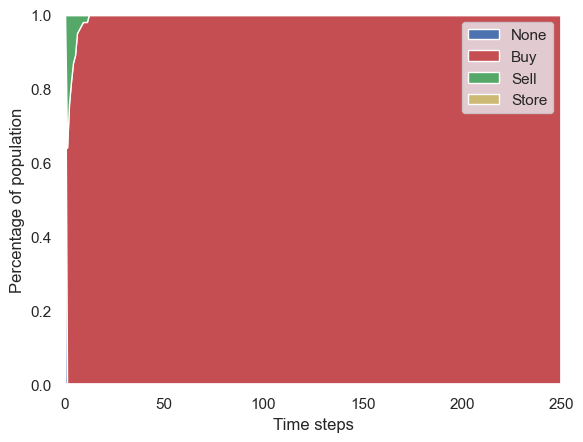

In [196]:
def EnergyShed_stackplot(data, ax):
    """ Stackplot of people's condition over time. """
    x = data.index.get_level_values('t')
    y = [data[var] for var in ['None', 'Buy', 'Sell', 'Store']]

    sns.set()
    ax.stackplot(x, y, labels=['None', 'Buy', 'Sell', 'Store'],
                 colors = ['b', 'r', 'g', 'y'])

    ax.legend()
    ax.set_xlim(0, max(1, len(x)-1))
    ax.set_ylim(0, 1)
    ax.set_xlabel("Time steps")
    ax.set_ylabel("Percentage of population")

fig, ax = plt.subplots()
EnergyShed_stackplot(results.variables.EnergyShedModel, ax)


In [197]:
def animation_plot(m, axs):
    ax1, ax2 = axs
    ax1.set_title("EnergyShed spread")
    ax2.set_title(f"Share infected: {m.agents.energy_trans}")

    # Plot stackplot on first axis
    EnergyShed_stackplot(m.output.variables.EnergyShedModel, ax1)

    # Plot network on second axis
    color_dict = {0:'b', 1:'r', 2:'g', 3:'y'}
    colors = [color_dict[c] for c in m.agents.condition]
    nx.draw_circular(m.network.graph, node_color=colors,
                     node_size=50, ax=ax2)

fig, axs = plt.subplots(1, 2, figsize=(8, 4)) # Prepare figure
parameters['population'] = 50 # Lower population for better visibility
animation = ap.animate(EnergyShedModel(parameters), fig, axs, animation_plot)

In [198]:
IPython.display.HTML(animation.to_jshtml())

Animation size has reached 21097638 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [199]:
def animation_plot2(m, axs):
    ax1, ax2 = axs
    ax1.set_title("EnergyShed spread")
    ax2.set_title(f"Share infected: {m.agents.energy_trans}")

    # Plot stackplot on first axis
    EnergyShed_stackplot(m.output.variables.EnergyShedModel, ax1)

    # Plot network on second axis
    color_dict = {0:'b', 1:'r', 2:'g', 3:'y'}
    colors = [color_dict[c] for c in m.agents.condition]
    nx.draw(m.network.graph, node_color=colors,
                     node_size=50, ax=ax2)

fig, axs = plt.subplots(1, 2, figsize=(8, 4)) # Prepare figure
parameters['population'] = 50 # Lower population for better visibility
animation2 = ap.animate(EnergyShedModel(parameters), fig, axs, animation_plot2)

In [ ]:
IPython.display.HTML(animation2.to_jshtml())

In [10]:
parameters = {
    'population': ap.IntRange(100, 1000),
    'number_of_neighbors': 4,
    'network_randomness': ap.Range(0., 1.)
}

sample = ap.Sample(
    parameters,
    n=128,
    method='saltelli',
    calc_second_order=False
)

In [11]:
exp = ap.Experiment(EnergyShedModel, sample, iterations=10)
results = exp.run()

Scheduled runs: 7680
Completed: 7680, estimated time remaining: 0:00:00
Experiment finished
Run time: 0:03:36.745430


In [12]:
results.save()

Data saved to ap_output/VirusModel_1


In [13]:
results

DataDict {
'info': Dictionary with 12 keys
'parameters': 
    'constants': Dictionary with 2 keys
    'sample': DataFrame with 4 variables and 768 rows
    'log': Dictionary with 5 keys
'reporters': DataFrame with 3 variables and 7680 rows
}

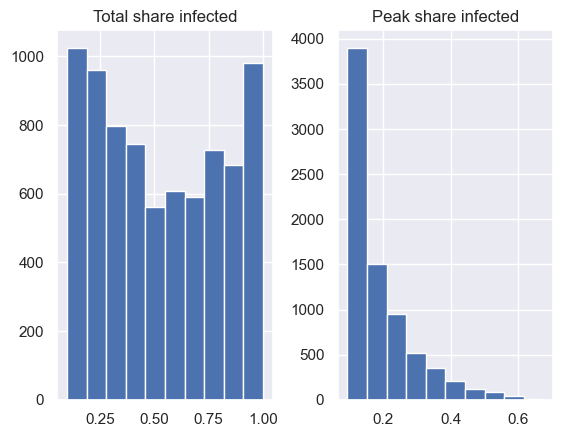

In [14]:
results.reporters.hist();

In [16]:
# Sensitivity Analysis

In [15]:
results.calc_sobol()

/Users/evartsb/opt/anaconda3/envs/abm-geo/lib/python3.9/site-packages/agentpy/datadict.py:148: FutureWarning: The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.
  reporters_df = self.reporters.groupby('sample_id').mean()


DataDict {
'info': Dictionary with 12 keys
'parameters': 
    'constants': Dictionary with 2 keys
    'sample': DataFrame with 4 variables and 768 rows
    'log': Dictionary with 5 keys
'reporters': DataFrame with 3 variables and 7680 rows
'sensitivity': 
    'sobol': DataFrame with 2 variables and 8 rows
    'sobol_conf': DataFrame with 2 variables and 8 rows
}

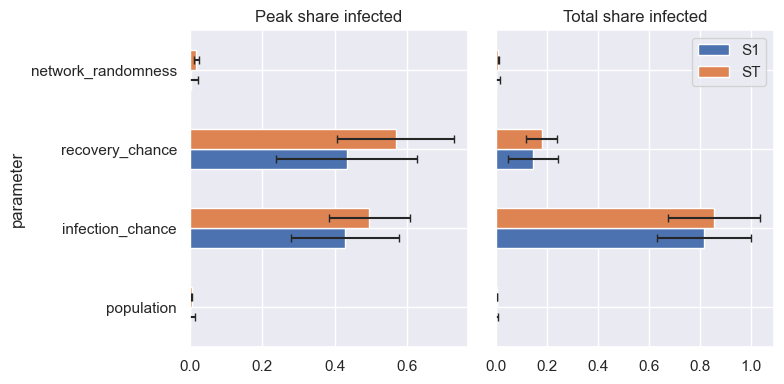

In [17]:
def plot_sobol(results):
    """ Bar plot of Sobol sensitivity indices. """

    sns.set()
    fig, axs = plt.subplots(1, 2, figsize=(8, 4))
    si_list = results.sensitivity.sobol.groupby(by='reporter')
    si_conf_list = results.sensitivity.sobol_conf.groupby(by='reporter')

    for (key, si), (_, err), ax in zip(si_list, si_conf_list, axs):
        si = si.droplevel('reporter')
        err = err.droplevel('reporter')
        si.plot.barh(xerr=err, title=key, ax=ax, capsize = 3)
        ax.set_xlim(0)

    axs[0].get_legend().remove()
    axs[1].set(ylabel=None, yticklabels=[])
    axs[1].tick_params(left=False)
    plt.tight_layout()

plot_sobol(results)

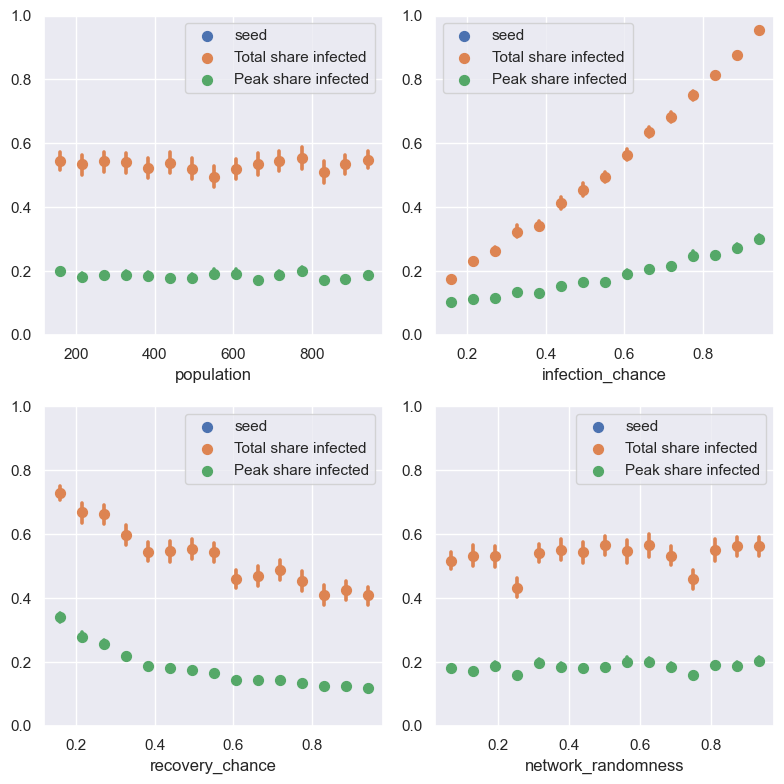

In [18]:
def plot_sensitivity(results):
    """ Show average simulation results for different parameter values. """

    sns.set()
    fig, axs = plt.subplots(2, 2, figsize=(8, 8))
    axs = [i for j in axs for i in j] # Flatten list

    data = results.arrange_reporters().astype('float')
    params = results.parameters.sample.keys()

    for x, ax in zip(params, axs):
        for y in results.reporters.columns:
            sns.regplot(x=x, y=y, data=data, ax=ax, ci=99,
                        x_bins=15, fit_reg=False, label=y)
        ax.set_ylim(0,1)
        ax.set_ylabel('')
        ax.legend()

    plt.tight_layout()

plot_sensitivity(results)

In [32]:
rng = random.randrange(10) + random.random()
rng

5.154598679047444

In [64]:
round(random.triangular(0.4, 1.5),1)

0.6